# 1.1 Viz Top 5K Gene Dataset

In [44]:
import pandas as pd
import gene_exp_10x

import matplotlib.pyplot as plt
%matplotlib inline 
from copy import deepcopy

In [5]:
from clustergrammer2 import net

In [6]:
def umi_norm(df):
    # umi norm
    barcode_umi_sum = df.sum()
    df_umi = df.div(barcode_umi_sum)
    return df_umi

In [14]:
df_meta = pd.read_csv('../download/atlas/meta.tab', sep='\t', index_col=0)
df_meta.shape

/Users/nickfernandez/anaconda3/envs/py36lab/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (27) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


(139331, 27)

In [8]:
df_ini = gene_exp_10x.load_gene_exp_to_df('../download/atlas/atlas_data_5k-sum/')
df_ini.shape

(5000, 139331)

In [10]:
df_ini.columns.tolist()[:3]

['cell_1', 'cell_2', 'cell_3']

In [15]:
df_meta.columns.tolist()

['barcode',
 'sample',
 'stage',
 'sequencing.batch',
 'theiler',
 'doub.density',
 'doublet',
 'cluster',
 'cluster.sub',
 'cluster.stage',
 'cluster.theiler',
 'stripped',
 'celltype',
 'colour',
 'umapX',
 'umapY',
 'haem_gephiX',
 'haem_gephiY',
 'haem_subclust',
 'endo_gephiX',
 'endo_gephiY',
 'endo_trajectoryName',
 'endo_trajectoryDPT',
 'endo_gutX',
 'endo_gutY',
 'endo_gutDPT',
 'endo_gutCluster']

### Drop doublets

In [20]:
ser_doublet = df_meta['doublet']
ser_singlet = ser_doublet[ser_doublet == False]
print(ser_doublet.shape)
print(ser_singlet.shape)

(139331,)
(125775,)


In [21]:
ser_ct = df_meta['celltype']

In [26]:
ser_ct.value_counts().sort_values(ascending=False)

Epiblast                          14619
ExE ectoderm                      11758
ExE endoderm                       9339
Primitive Streak                   7265
Rostral neurectoderm               5392
Nascent mesoderm                   5028
Mesenchyme                         4979
Forebrain/Midbrain/Hindbrain       4854
Paraxial mesoderm                  3811
Intermediate mesoderm              3551
Surface ectoderm                   3523
Pharyngeal mesoderm                3086
Erythroid1                         2929
Haematoendothelial progenitors     2733
Erythroid3                         2697
Blood progenitors 2                2587
ExE mesoderm                       2571
Caudal epiblast                    2445
Somitic mesoderm                   2079
NMP                                2041
Mixed mesoderm                     1994
Gut                                1940
Allantois                          1820
Spinal cord                        1796
Visceral endoderm                  1283


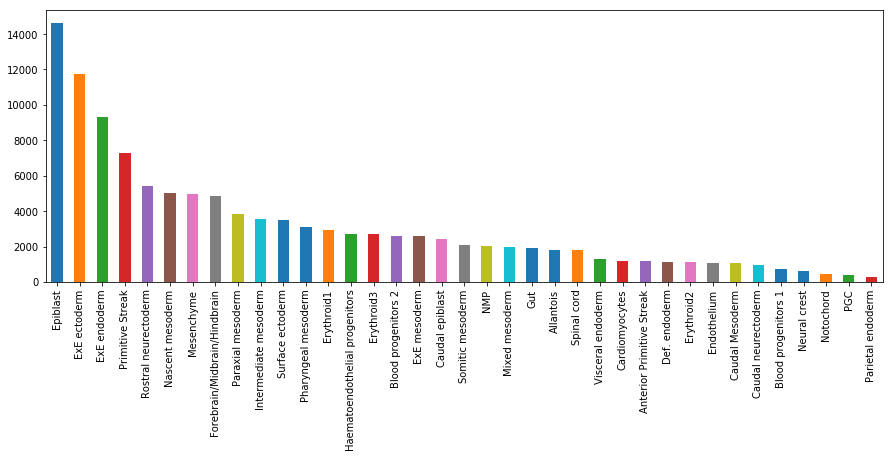

In [25]:
ser_ct.value_counts().sort_values(ascending=False).plot('bar', figsize=(15,5))

### Add Cell Type Category

In [33]:
ser_ct['cell_1']

'Epiblast'

In [35]:
ser_ct[cols[0]]

'Epiblast'

In [42]:
cols = df_ini.columns.tolist()
new_cols = [(x, 'Cell Type: ' + str(ser_ct[x])) for x in cols]

In [45]:
print(new_cols[0])
df_cat = deepcopy(df_ini)
df_cat.columns = new_cols

('cell_1', 'Cell Type: Epiblast')


In [46]:
df_cat.columns.tolist()[:5]

[('cell_1', 'Cell Type: Epiblast'),
 ('cell_2', 'Cell Type: Primitive Streak'),
 ('cell_3', 'Cell Type: nan'),
 ('cell_4', 'Cell Type: nan'),
 ('cell_5', 'Cell Type: ExE ectoderm')]

In [47]:
gene_sum = df_cat.sum(axis=1)
gene_sum.shape

(5000,)

In [48]:
num_cells = 10000
df_small = umi_norm(df_cat.iloc[:,:num_cells])
df_small.shape

(5000, 10000)

In [49]:
net.load_df(df_small)
net.filter_N_top(inst_rc='row', N_top=250, rank_type='var')
net.normalize(axis='row', norm_type='zscore')
net.clip(-5,5)
net.load_df(net.export_df().round(2))
net.widget()

ExampleWidget(network='{"row_nodes": [{"name": "Ptma", "ini": 250, "clust": 113, "rank": 235, "rankvar": 197, …